In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
import numpy as np
import scipy as sp
import theano as th
import theano.tensor as tt
import statsmodels.api as sm
import matplotlib.pyplot as plt
from IPython.html.widgets import interact
import seaborn as sb
import g3py as gp
import pymc3 as pm

np.random.seed(123456)
th.config.floatX = 'float32'
th.config.on_unused_input = 'ignore'

/home/grios/anaconda3/lib/python3.5/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


# Data: Sunsets

::

    Number of Observations - 309 (Annual 1700 - 2008)
    Number of Variables - 1
    Variable name definitions::

        SUNACTIVITY - Number of sunspots for each year

    The data file contains a 'YEAR' variable that is not returned by load.



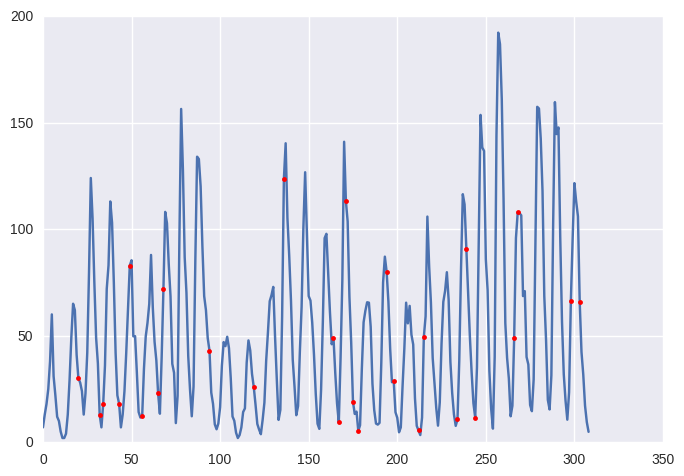

In [2]:
data = sm.datasets.sunspots.load_pandas().data['SUNACTIVITY']
print(sm.datasets.sunspots.NOTE)
n , d, x_e , y_e = len(data), 10, 1, 1

x = data.index.values[:n]/x_e
y = data.values[:n]/y_e
y = y + 2

obs_j = np.unique(np.sort(np.random.randint(0,n,n//d)))
test_j = np.array([v for v in np.arange(len(x)) if v not in obs_j])

x_obs = x[obs_j]
y_obs = y[obs_j]

x_test = x[test_j]
y_test = y[test_j]

plt.plot(x,y)
plt.plot(x_obs,y_obs,'.r')

warning in stationary: failed to import cython module: falling back to numpy


GP_regression.,value,constraints,priors
sum.rbf.variance,638.592327135,+ve,
sum.rbf.lengthscale,3.85846454393e-21,+ve,
sum.bias.variance,2000.22725379,+ve,
Gaussian_noise.variance,647.777547789,+ve,


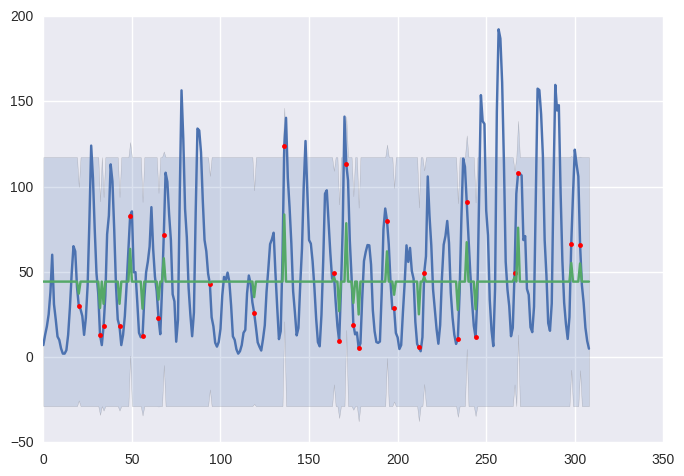

In [3]:
import GPy

m = GPy.models.GPRegression(x_obs[:,np.newaxis],y_obs[:,np.newaxis],GPy.kern.RBF(input_dim=1)+GPy.kern.Bias(input_dim=1))
m.optimize(messages=True)

mean,var = m.predict(x[:,np.newaxis],full_cov=False)
mean = mean[:,0]
var = var[:,0]

plt.plot(x,y)
plt.plot(x_obs,y_obs,'.r')

plt.plot(x,mean)
plt.fill_between(x, mean+2*np.sqrt(var), mean-2*np.sqrt(var), alpha=0.2, label='95%')
m

# Style Plots

In [4]:
#gp.style_seaborn()
gp.style_normal()
#gp.style_big()
#gp.style_big_seaborn()

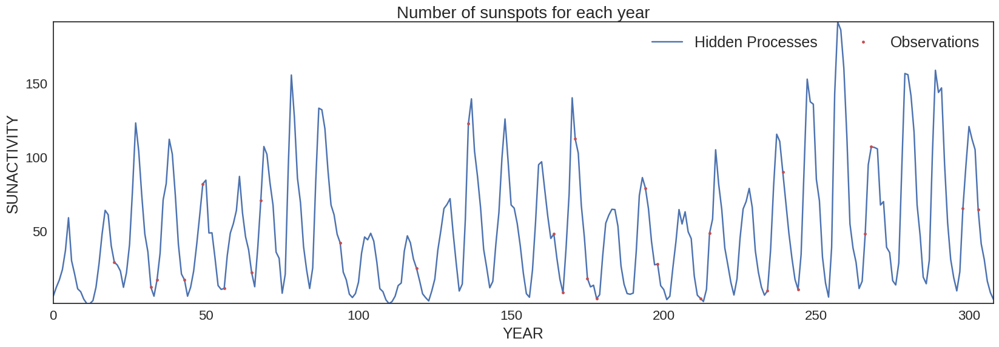

In [5]:
plt.plot(x,y,label='Hidden Processes')
plt.plot(x_obs,y_obs,'.r',label='Observations')
gp.plot('Number of sunspots for each year','YEAR','SUNACTIVITY',loc=1)

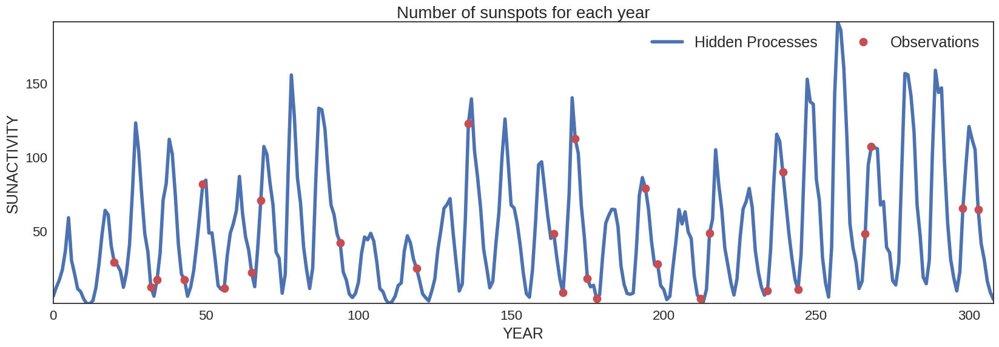

In [6]:
plt.plot(x,y,linewidth=4,label='Hidden Processes')
plt.plot(x_obs,y_obs,'.r',ms=20,label='Observations')
gp.plot('Number of sunspots for each year','YEAR','SUNACTIVITY',loc=1)

In [7]:
def plot_data():
    plt.plot(x, y, linewidth=4, label='Hidden Processes')
    plt.plot(x_obs, y_obs, '.r', ms=20, label='Observations')
    
def plot_gp(model,**params):
    mean, variance = g3.plot_posterior(mu, var, x,**params)
    logp_train = np.nanmean(model.logp(params))
    
    g3.inputs.set_value(x_test.astype(th.config.floatX))
    g3.outputs.set_value(x_test.astype(th.config.floatX))
    logp_test = np.nanmean(model.logp(params))

    g3.inputs.set_value(x_obs.astype(th.config.floatX))
    g3.outputs.set_value(y_obs.astype(th.config.floatX))
    
    mse = np.nanmean((y - mean) ** 2 + variance)
    mab = np.nanmean(np.abs(y - mean))
    title = 'll_train={:.2f} | ll_test={:.2f} | mse={:.2f}  | bias={:.2f}'.format(logp_train, logp_test,mse,mab)
    gp.plot('Standard GP: '+title,'YEAR','SUNACTIVITY',loc=1)


def plot_tgp(model,**params):
    moment1, moment2 = g3.plot_posterior_hermite(m1,m2,x,**params)
    med, Iup, Idow = g3.plot_posterior_quantiles(median, I_up, I_down,x,**params)
    #moment1, moment2 = m1(**params), m2(**params)
    
    mean = moment1
    variance = moment2 - moment1**2
    
    logp_train = np.nanmean(model.logp(params))
    
    g3.inputs.set_value(x_test.astype(th.config.floatX))
    g3.outputs.set_value(x_test.astype(th.config.floatX))
    logp_test = np.nanmean(model.logp(params))

    g3.inputs.set_value(x_obs.astype(th.config.floatX))
    g3.outputs.set_value(y_obs.astype(th.config.floatX))

    
    
    mse = np.nanmean((y - mean) ** 2 + variance)
    mab = np.nanmean(np.abs(y - mean))
    title = 'll_train={:.2f} | ll_test={:.2f} | mse={:.2f}  | bias={:.2f}'.format(logp_train, logp_test,mse,mab)
    gp.plot('Box-Cox GP: '+title,'YEAR','SUNACTIVITY',loc=1)
    

# GP

Applied log-transform to ARD_L2 and added transformed ARD_L2_log_ to model.
Applied log-transform to VAR_SE and added transformed VAR_SE_log_ to model.


The output file is available at temp.png


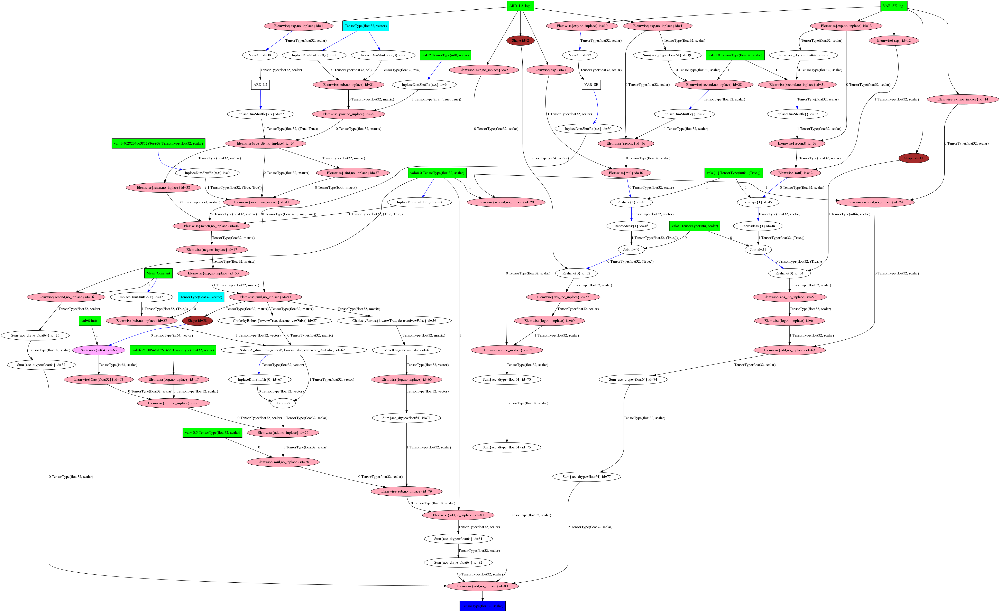

In [22]:
with gp.G3Model() as model:
    g3 = gp.G3GP(gp.Constant(), gp.SE(x,gp.ARD_L2), gp.Identity(y))
    g3.observed(x_obs,y_obs)
    mu, var, median, I_up, I_down, m1, m2 = g3.compilate_functions(model.vars,x)
    
model.use_prior()
gp.show_graph(model.logpt)

The output file is available at temp.png


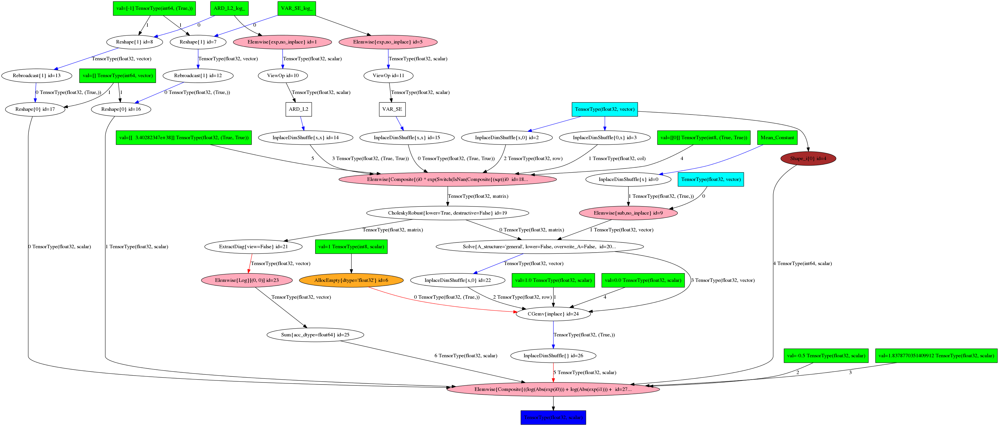

In [23]:
gp.show_graph(model.fastlogp.f)

The output file is available at temp.png


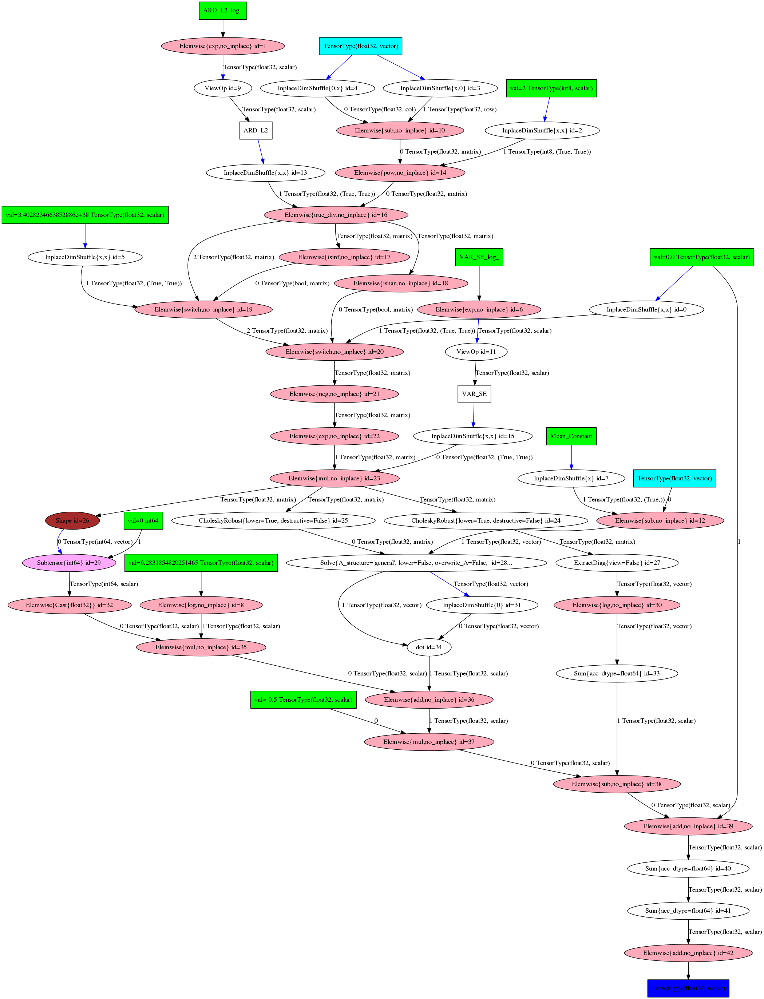

In [11]:
model.use_prior(False)
gp.show_graph(model.logpt)

The output file is available at temp.png


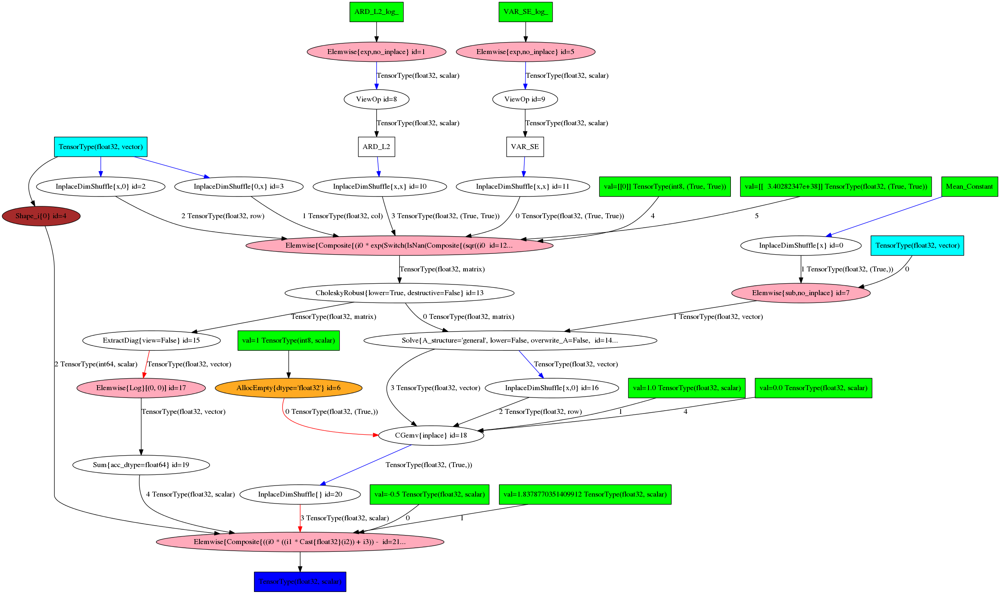

In [21]:
gp.show_graph(model.fastlogp.f)

In [25]:
model.vars

[Mean_Constant, ARD_L2_log_, VAR_SE_log_]

CPU times: user 3.77 s, sys: 7.61 s, total: 11.4 s
Wall time: 2.6 s
CPU times: user 4.1 s, sys: 7.13 s, total: 11.2 s
Wall time: 3.5 s
CPU times: user 4.52 s, sys: 7.88 s, total: 12.4 s
Wall time: 2.92 s
CPU times: user 3.51 s, sys: 7.19 s, total: 10.7 s
Wall time: 2.37 s


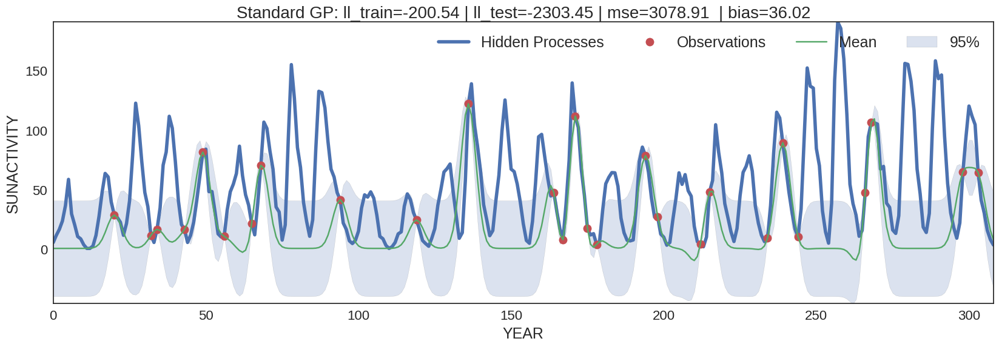

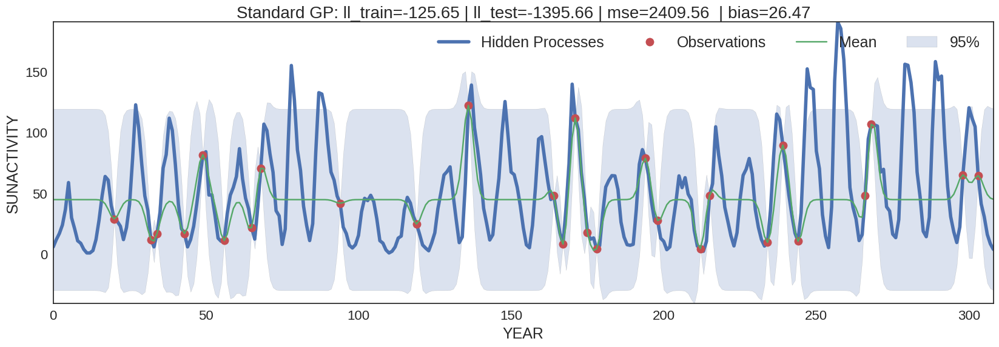

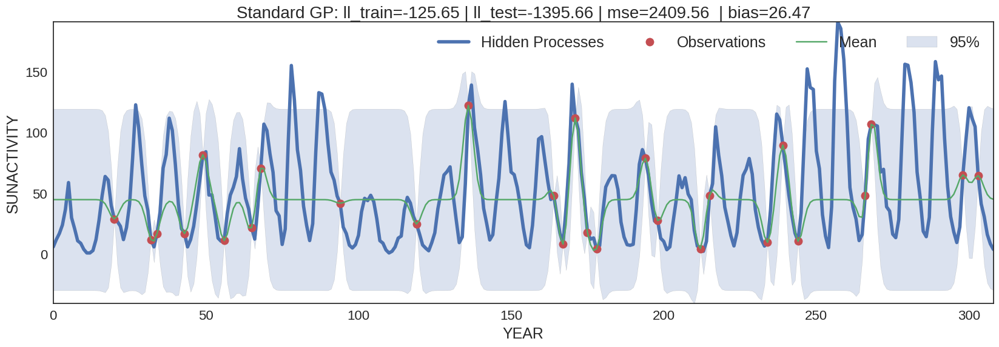

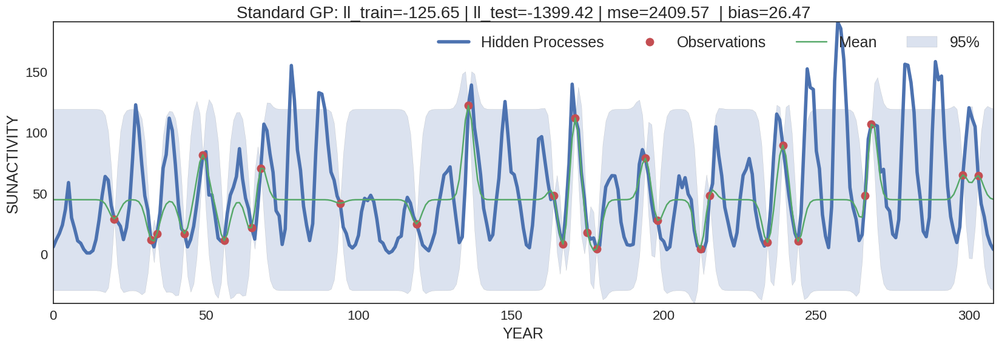

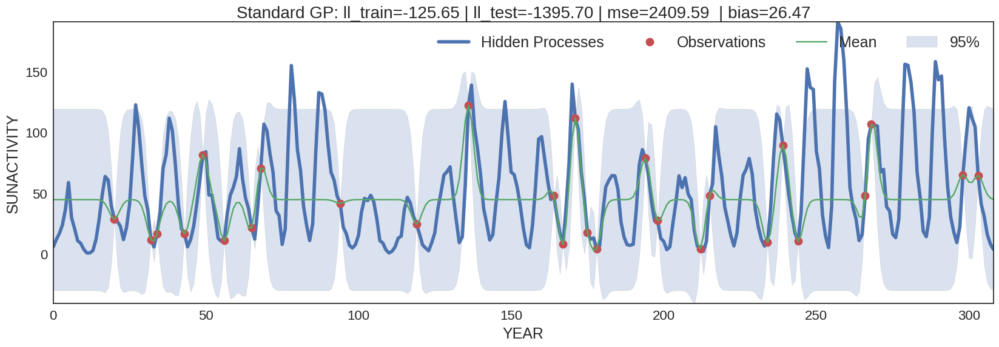

In [27]:
init = {'ARD_L2_log_': np.array(2.5, dtype=np.float32),
         'VAR_SE_log_': np.array(6.0, dtype=np.float32),
         'Mean_Constant': np.array(2, dtype=np.float32)
       }
with model:
    #model.use_prior(False)
    %time start_bfgs = pm.find_MAP(fmin=sp.optimize.fmin_bfgs,start=init)
    %time new_bfgs = pm.find_MAP(fmin=sp.optimize.fmin_bfgs,start=start_bfgs,vars=model.VAR_SE_log_)
    %time start_powell = pm.find_MAP(fmin=sp.optimize.fmin_powell,start=init)
    %time new_powell = pm.find_MAP(fmin=sp.optimize.fmin_powell,start=start_bfgs)

plt.figure(0)
plot_data()
plot_gp(model,**init)

plt.figure(1)
plot_data()
plot_gp(model,**start_bfgs)

plt.figure(2)
plot_data()
plot_gp(model,**new_bfgs)

plt.figure(3)
plot_data()
plot_gp(model,**start_powell)

plt.figure(4)
plot_data()
plot_gp(model,**new_powell)


{'ARD_L2_log_': array(2.4893999099731445, dtype=float32),
 'COV_SE_log_': array([ 7.1715064 ,  6.33118105], dtype=float32),
 'Mean_Constant': array(60.32984924316406, dtype=float32)}

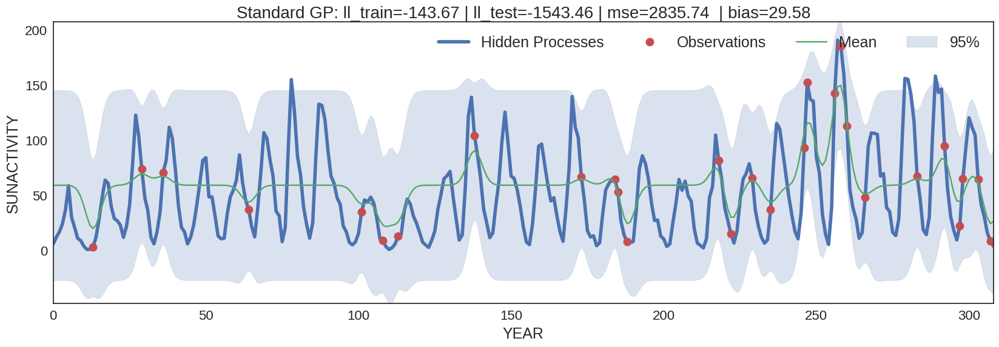

In [32]:
params = start_powell

plt.figure(1)
plot_data()
plot_gp(model,**params)
gp.save('gp_learning.pdf')


params

In [33]:
with model:
    advi_mu,advi_sm,advi_elbo = pm.advi(start=params)

Iteration 0 [0%]: ELBO = -164.77
Iteration 500 [10%]: Average ELBO = -126.46
Iteration 1000 [20%]: Average ELBO = -125.68
Iteration 1500 [30%]: Average ELBO = -125.02
Iteration 2000 [40%]: Average ELBO = -124.7
Iteration 2500 [50%]: Average ELBO = -123.93
Iteration 3000 [60%]: Average ELBO = -123.32
Iteration 3500 [70%]: Average ELBO = -123.01
Iteration 4000 [80%]: Average ELBO = -122.62
Iteration 4500 [90%]: Average ELBO = -122.57
Finished [100%]: Average ELBO = -121.77


In [34]:
n = 5000
with model:
    step = pm.HamiltonianMC(scaling=advi_sm)
    trace = pm.sample(n,step=step,start=advi_mu)

 53%|█████▎    | 2627/5000 [01:26<01:09, 34.27it/s]

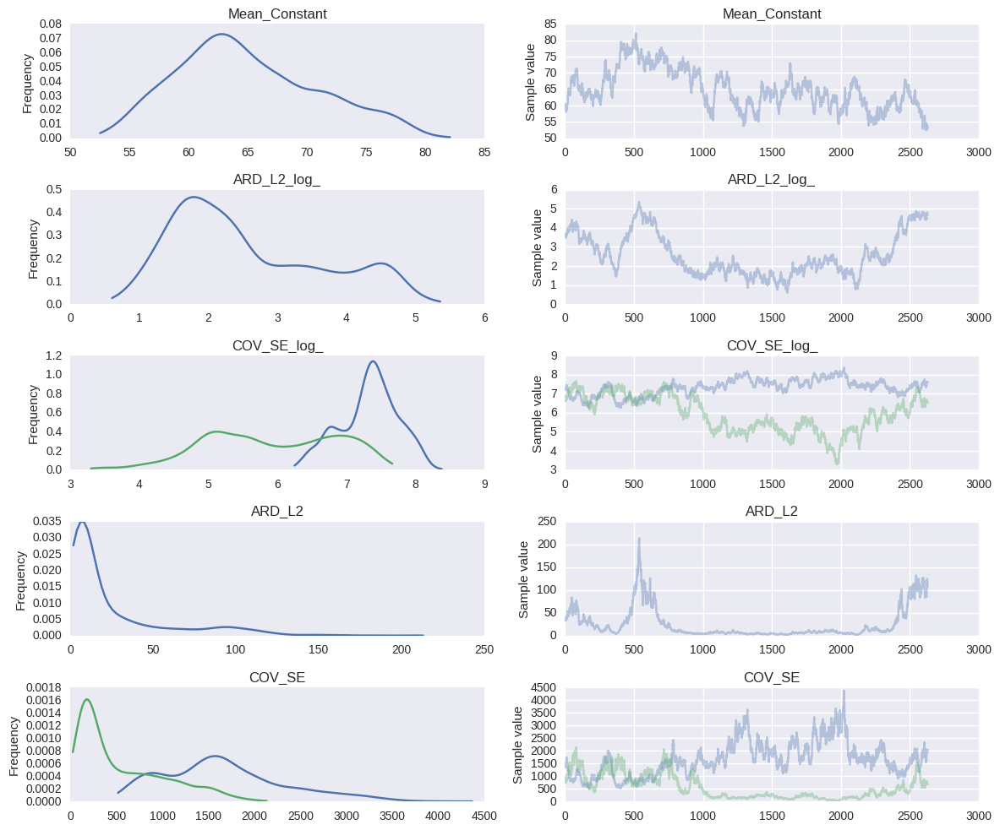

In [35]:
gp.style_seaborn()
_ = pm.traceplot(trace,plot_transformed=True)
def get_model(i):
    return {v.name:trace[i][v.name] for v in model.vars}

In [36]:
datatrace = gp.trace_to_dataframe(trace,hide_transformed_vars=False)
gp.add_likelihood_to_dataframe(model,datatrace,trace)
datatrace.describe().T

,count,mean,std,min,25%,50%,75%,max
COV_SE__0,2629.0,1659.585205,670.122131,518.080505,1172.239014,1589.578125,2017.547119,4369.376953
COV_SE__1,2629.0,555.020752,474.588501,27.090881,168.634430,346.115204,869.868469,2134.831299
Mean_Constant,2629.0,65.012924,5.962994,52.511730,60.703918,64.099411,68.998718,82.106667
ARD_L2,2629.0,25.150471,33.085236,1.831635,5.475769,9.536777,29.330732,212.998322
COV_SE_log___0,2629.0,7.329806,0.421167,6.250131,7.066671,7.371224,7.609638,8.382376
COV_SE_log___1,2629.0,5.910343,0.955065,3.299197,5.127733,5.846772,6.768342,7.666143
ARD_L2_log_,2629.0,2.559587,1.099562,0.605209,1.700333,2.255156,3.378636,5.361284
niter,2629.0,1314.000000,759.071253,0.000000,657.000000,1314.000000,1971.000000,2628.000000
ll,2629.0,-144.866566,0.742842,-147.991882,-145.302536,-144.733383,-144.319443,-143.312210
adll,2629.0,3.811127,1.831085,0.503600,2.371538,3.610405,5.032522,10.977963


 53%|█████▎    | 2627/5000 [01:40<01:30, 26.20it/s]

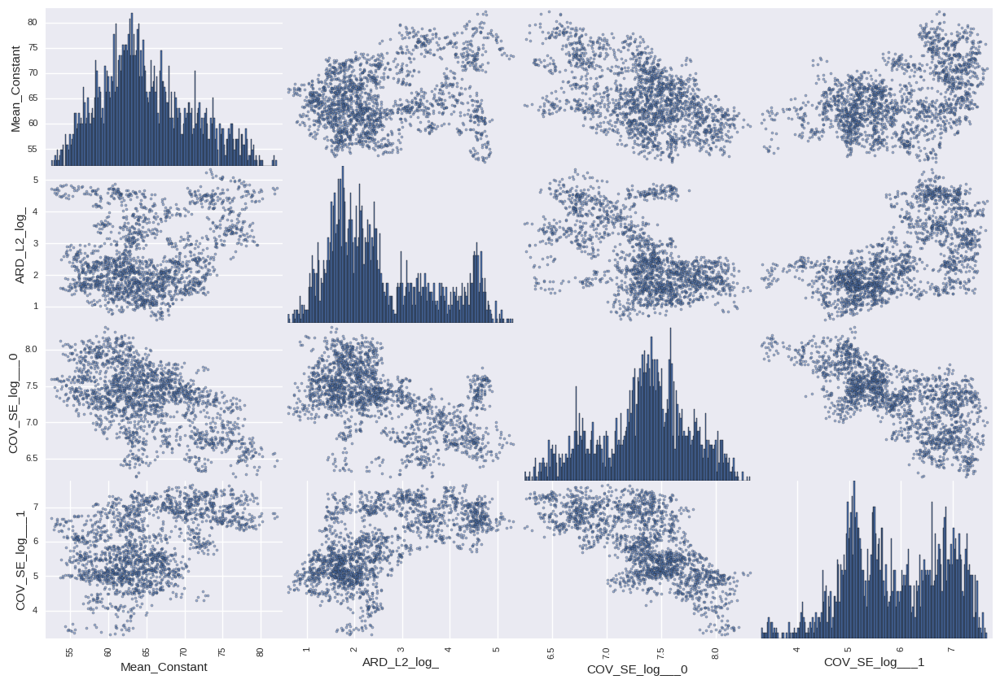

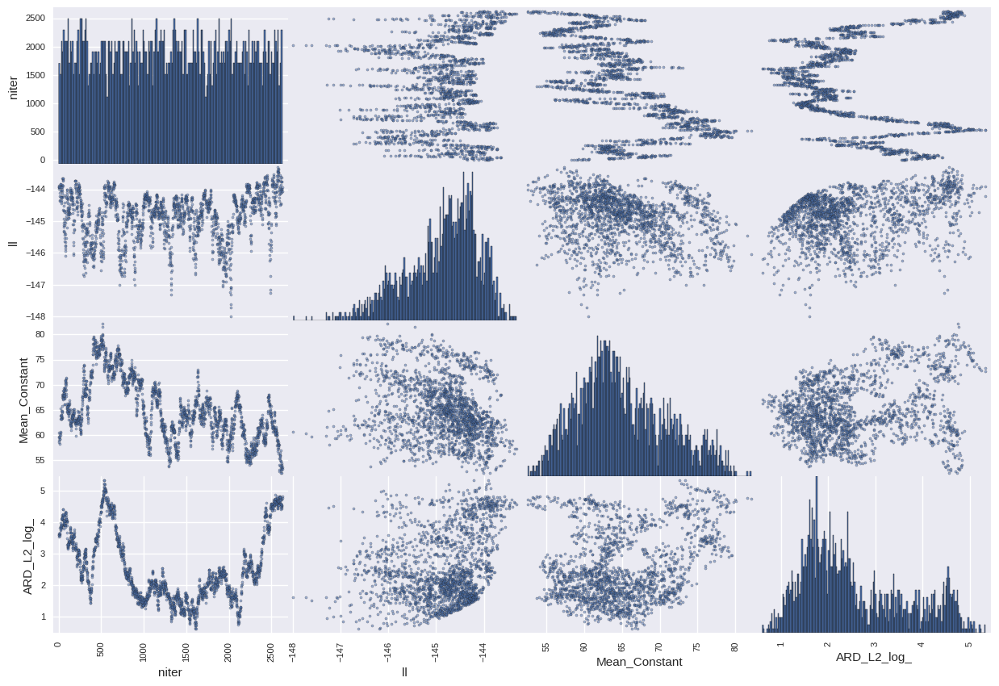

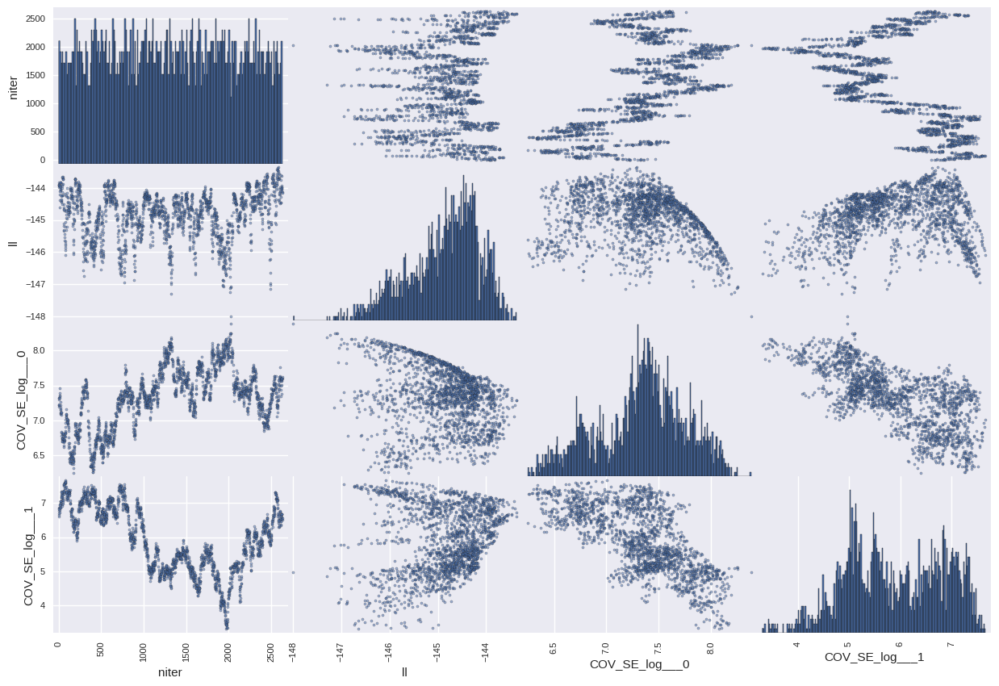

In [37]:
gp.style_seaborn()
items_ll = ['niter','ll']
items_mt = ['Mean_Constant','ARD_L2_log_']
items_k = ['COV_SE_log___0','COV_SE_log___1']

gp.scatter_trace(datatrace,items=(items_mt+items_k))
gp.scatter_trace(datatrace,items=(items_ll+items_mt))
gp.scatter_trace(datatrace,items=(items_ll+items_k))

In [38]:
def conditional(datatrace, lambda_df):
    conditional_traces = datatrace.loc[lambda_df, :]
    print('#'+str(len(conditional_traces)) + " (" + str(100 * len(conditional_traces) / len(datatrace)) + " %)")
    return conditional_traces

def plot_df_items(df,items):
    df = gp.marginal(df,items)
    g = sb.PairGrid(df,size=10)
    g.map_diag(sb.distplot)
    g.map_offdiag(plt.scatter)
    g.map_offdiag(sb.kdeplot, cmap="Blues_d", n_levels=30)

gp.conditional = conditional

In [39]:
condition = lambda df: True & (df['ll'] < 100.0)
conditional_traces = gp.conditional(datatrace, condition)

#2629 (100.0 %)


 /home/grios/anaconda3/lib/python3.5/site-packages/statsmodels/nonparametric/kdetools.py:20: VisibleDeprecationWarning:using a non-integer number instead of an integer will result in an error in the future


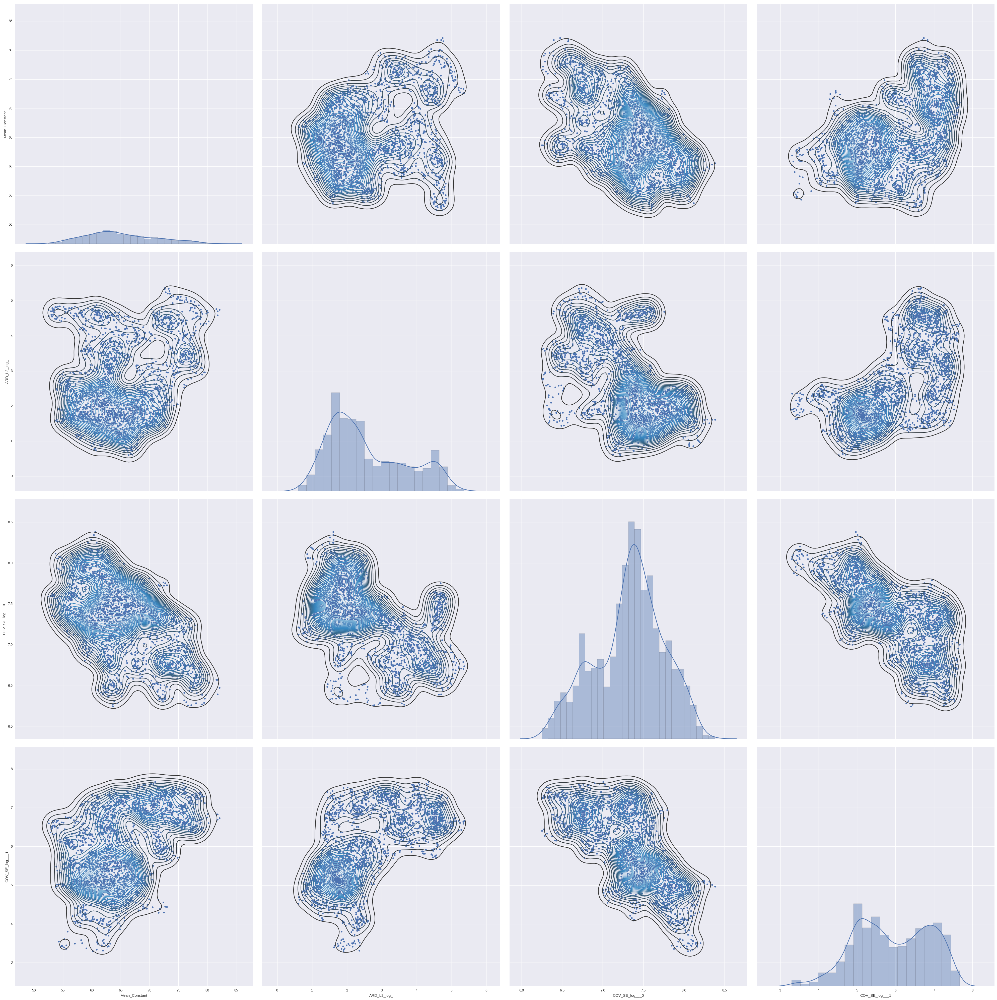

In [40]:
plot_df_items(conditional_traces,items_mt+items_k)

 /home/grios/anaconda3/lib/python3.5/site-packages/statsmodels/nonparametric/kdetools.py:20: VisibleDeprecationWarning:using a non-integer number instead of an integer will result in an error in the future


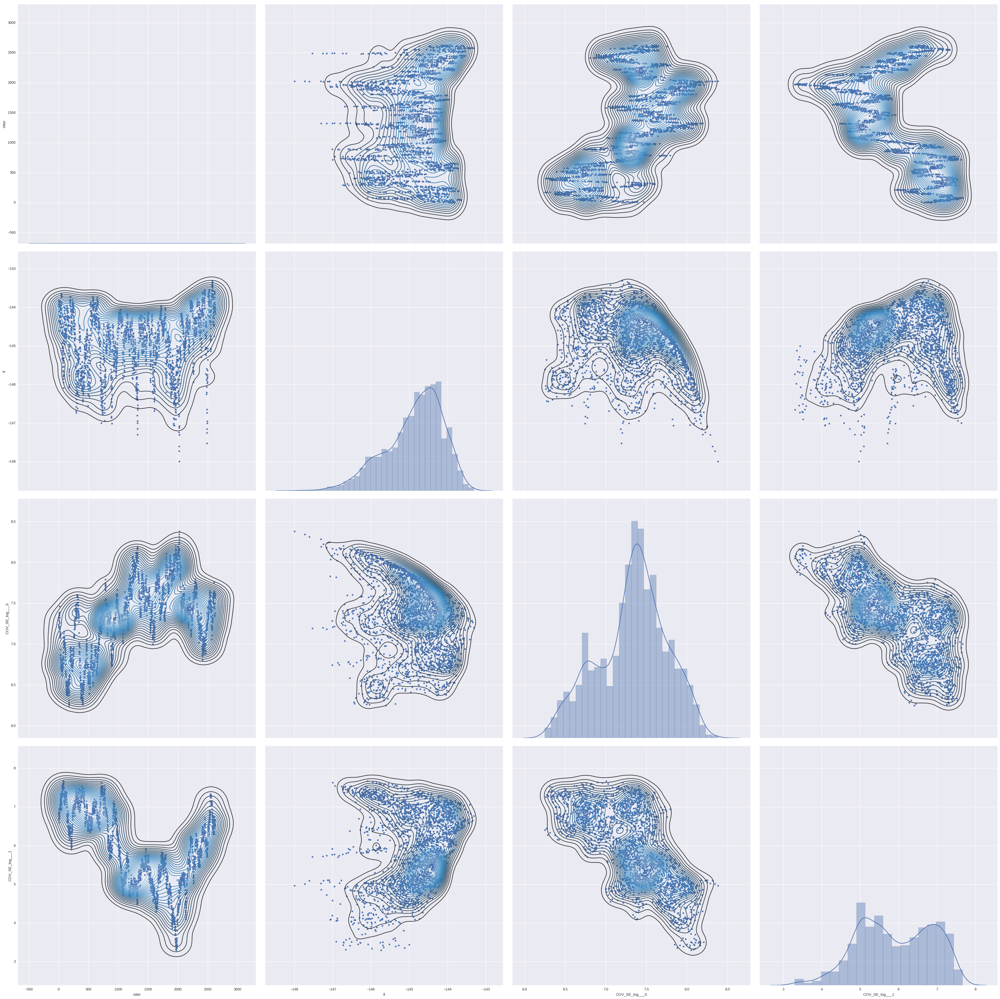

In [41]:
plot_df_items(conditional_traces,items_ll+items_k)

 /home/grios/anaconda3/lib/python3.5/site-packages/statsmodels/nonparametric/kdetools.py:20: VisibleDeprecationWarning:using a non-integer number instead of an integer will result in an error in the future


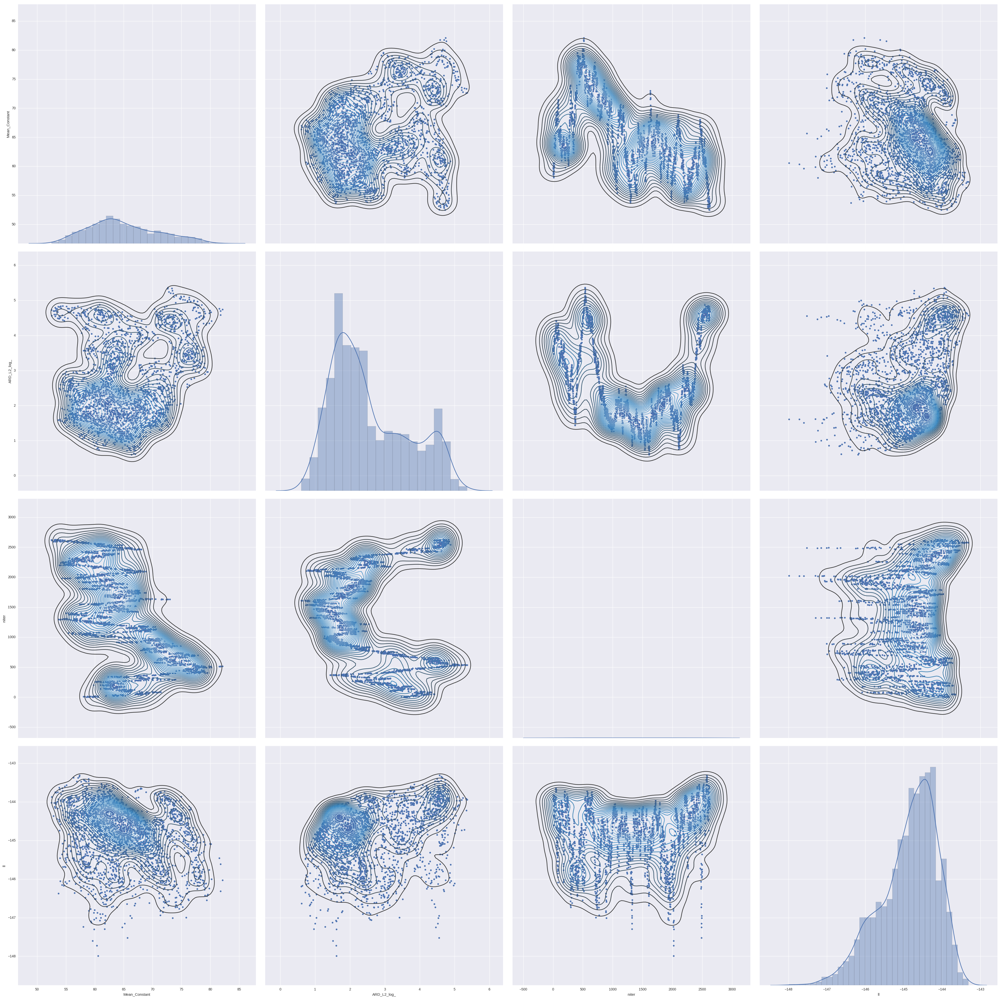

In [42]:
plot_df_items(conditional_traces,items_mt+items_ll)

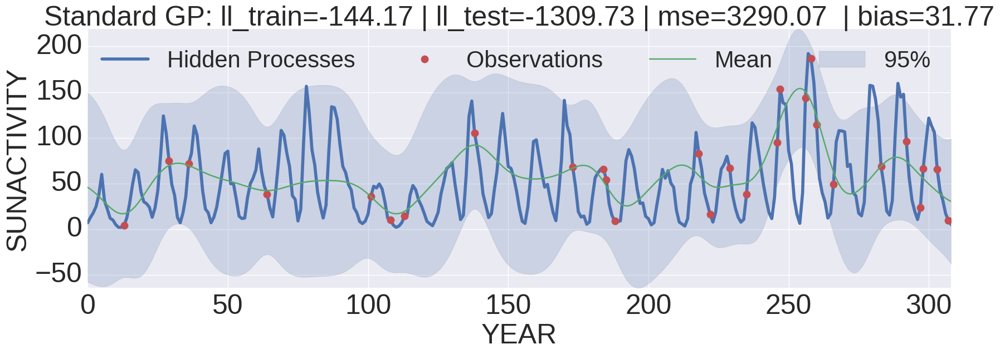

In [43]:
gp.style_big_seaborn()
@interact(idmodel=[0, len(trace)-1])
def plot_model(idmodel=0):
    plot_data()
    plot_gp(model,**get_model(int(idmodel)))

In [ ]:
plot_data()
plot_gp(model,**params)

# Box-Cox GP

In [851]:
with gp.G3Model() as model:
    g3 = gp.G3GP(gp.Constant(), gp.SE(gp.ARD_L2(x)), gp.BoxCoxShifted(y))
    g3.observed(x_obs,y_obs)
    mu, var, median, I_up, I_down, m1, m2 = g3.compilate_functions(model.vars,x)
model.use_prior(False)
#gp.show_graph(model.logpt)

Applied log-transform to ARD_L2 and added transformed ARD_L2_log_ to model.
Applied log-transform to COV_SE and added transformed COV_SE_log_ to model.
Applied log-transform to T_Power and added transformed T_Power_log_ to model.


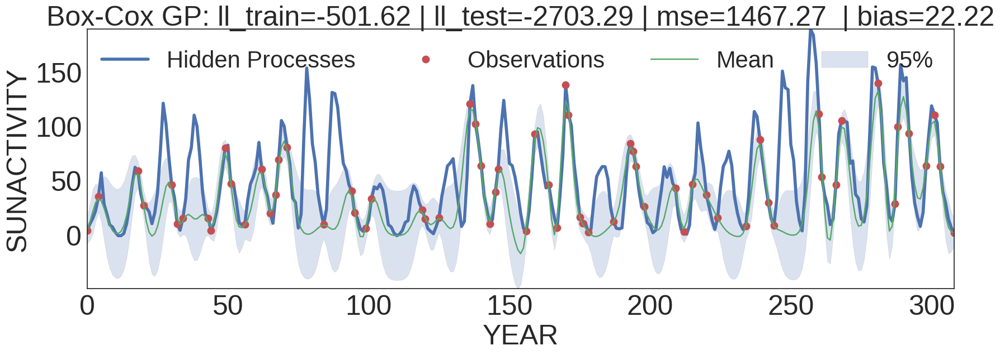

In [852]:
init = {'ARD_L2_log_': np.array(2.5, dtype=np.float32),
         'COV_SE_log_': np.array([ 6, 3 ], dtype=np.float32),
         'Mean_Constant': np.array(2, dtype=np.float32),
         'T_Shift': np.array(1.0, dtype=np.float32),
         'T_Power_log_': np.array(0.0, dtype=np.float32),
       }
plt.figure(0)
plot_data()
plot_tgp(model,**init)

In [853]:
th.config.mode='FAST_COMPILE'

CPU times: user 6.92 s, sys: 17.8 s, total: 24.7 s
Wall time: 3.87 s
CPU times: user 3.66 s, sys: 10.4 s, total: 14.1 s
Wall time: 1.96 s
CPU times: user 6.48 s, sys: 19.2 s, total: 25.7 s
Wall time: 3.47 s
CPU times: user 6.44 s, sys: 19.1 s, total: 25.5 s
Wall time: 3.49 s


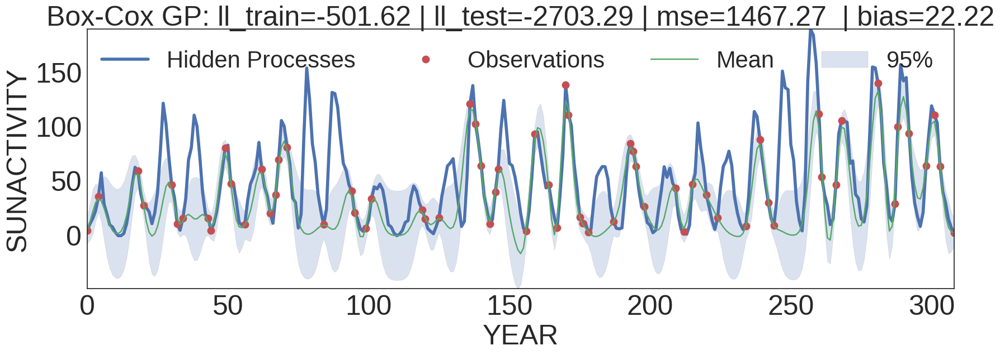

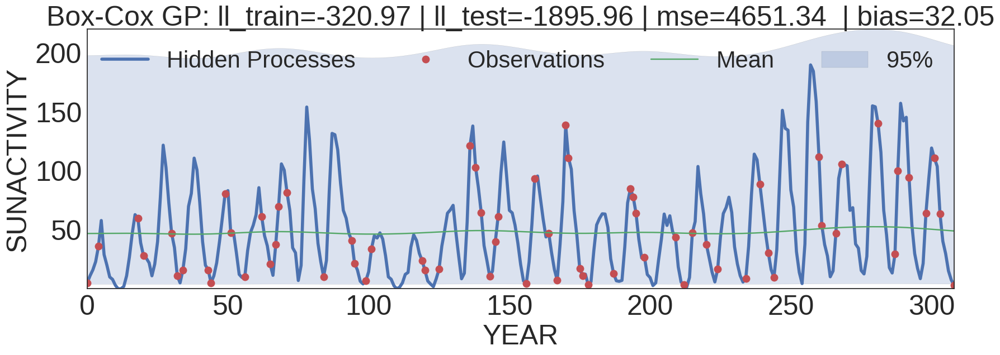

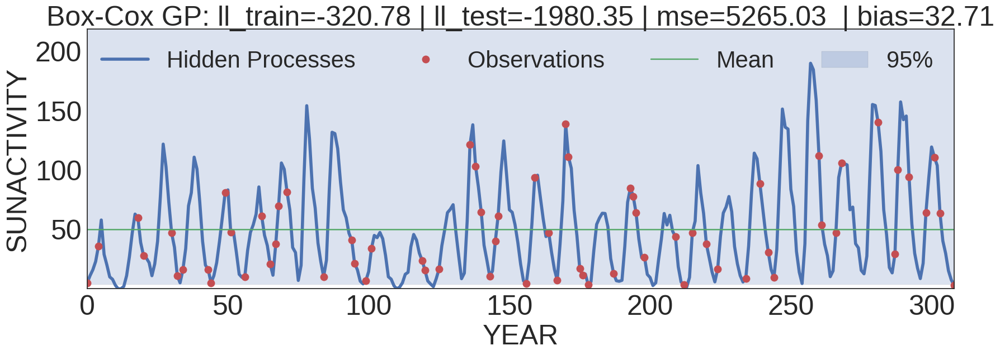

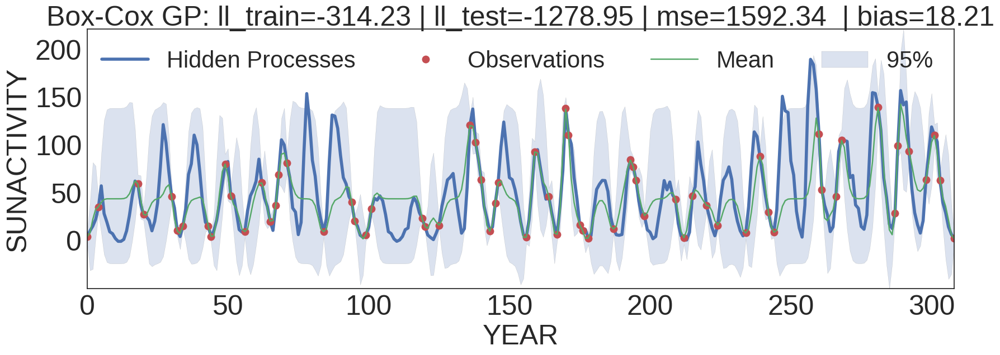

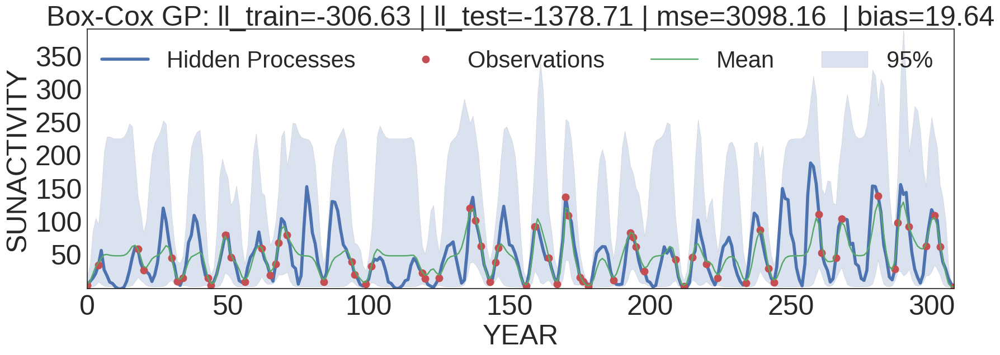

In [854]:
with model:
    #model.use_prior(False)
    %time start_bfgs = pm.find_MAP(fmin=sp.optimize.fmin_bfgs,start=init)
    %time new_bfgs = pm.find_MAP(fmin=sp.optimize.fmin_bfgs,start=start_bfgs,vars=model.COV_SE_log_)
    %time start_powell = pm.find_MAP(fmin=sp.optimize.fmin_powell,start=init)
    %time new_powell = pm.find_MAP(fmin=sp.optimize.fmin_powell,start=start_bfgs)

plt.figure(0)
plot_data()
plot_tgp(model,**init)

plt.figure(1)
plot_data()
plot_tgp(model,**start_bfgs)

plt.figure(2)
plot_data()
plot_tgp(model,**new_bfgs)

plt.figure(3)
plot_data()
plot_tgp(model,**start_powell)

plt.figure(4)
plot_data()
plot_tgp(model,**new_powell)

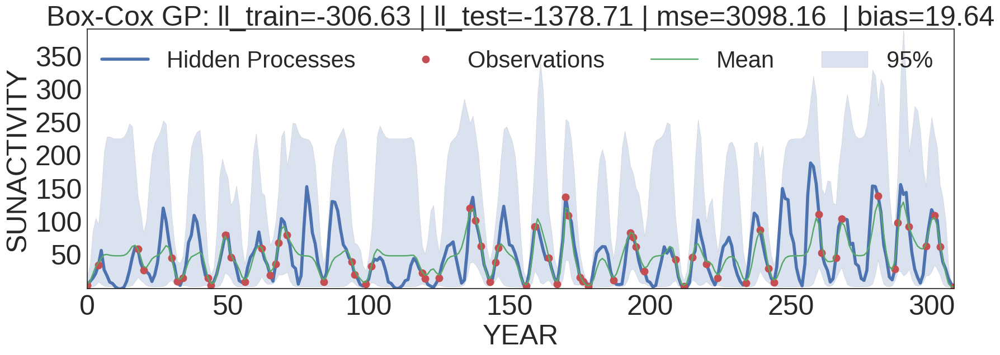

In [855]:
gp.style_big()
params = new_powell

plt.figure(1)
plot_data()
plot_tgp(model,**params)
gp.save('tgp_learning.pdf')

In [856]:
new_powell

{'ARD_L2_log_': array(1.836987853050232, dtype=float32),
 'COV_SE_log_': array([ 1.81526077, -0.1936231 ], dtype=float32),
 'Mean_Constant': array(4.632904529571533, dtype=float32),
 'T_Power_log_': array(-1.5855495929718018, dtype=float32),
 'T_Shift': array(-4.899999618530273, dtype=float32)}

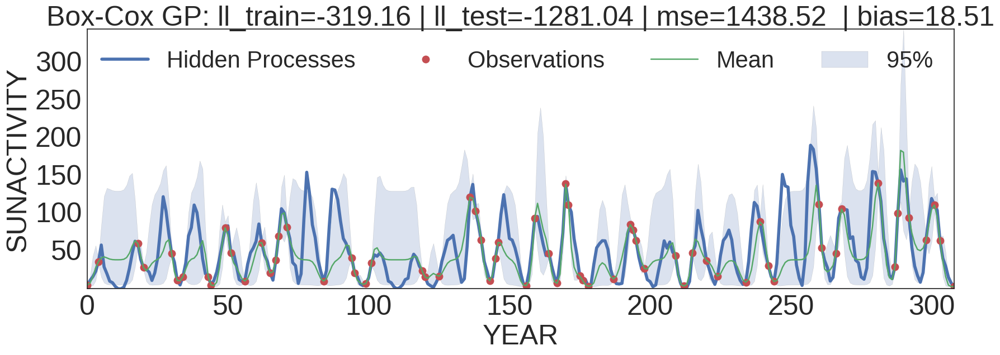

In [857]:
new_powell['COV_SE_log_'][0] = 1.2
new_powell['COV_SE_log_'][1] = -5.0
plot_data()
plot_tgp(model,**params)
gp.save('tgp_learning.pdf')

# Transformación

In [828]:
hidden_var = np.linspace(-10,5,501)
params = {'ARD_L2_log_': np.array(2.5, dtype=np.float32),
         'COV_SE_log_': np.array([ 2, -3 ], dtype=np.float32),
         'Mean_Constant': np.array(3.0, dtype=np.float32),
         'T_Shift': np.array(0.0, dtype=np.float32),
         'T_Power_log_': np.array(-0.4, dtype=np.float32),
       }
trans, dtrans, dist_gp, dist_tgp = g3.compile_distributions(model.point_to_In(params))
params

{'ARD_L2_log_': array(2.5, dtype=float32),
 'COV_SE_log_': array([ 2., -3.], dtype=float32),
 'Mean_Constant': array(3.0, dtype=float32),
 'T_Power_log_': array(-0.4000000059604645, dtype=float32),
 'T_Shift': array(0.0, dtype=float32)}

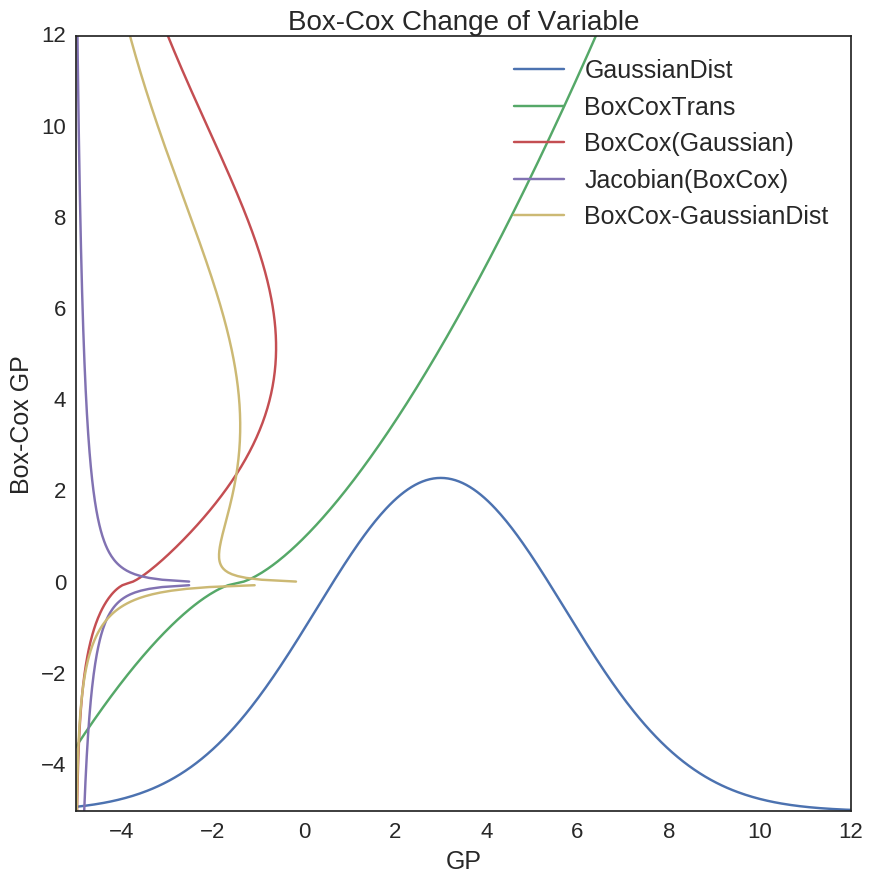

In [829]:
grilla = np.linspace(-5,15,501)
gp.style_normal()
plt.figure(1,(10,10))

desfase = 5


yyy = np.zeros_like(grilla)
i = 0
for xxx in grilla:
    yyy[i] = dist_gp(np.array([xxx]))
    i+=1
plt.plot(grilla,yyy*50-desfase,label='GaussianDist')


plt.plot(trans(grilla),grilla,label='BoxCoxTrans')


yyy = np.zeros_like(grilla)
i = 0
for xxx in trans(grilla):
    yyy[i] = dist_gp(np.array([xxx]))
    i+=1
plt.plot(yyy*30-desfase,grilla,label='BoxCox(Gaussian)')


i = 0
for xxx in grilla:
    yyy[i] = dtrans(np.array([xxx]))
    i+=1
plt.plot((yyy-np.min(yyy))-desfase,grilla,label='Jacobian(BoxCox)')


i = 0
for xxx in grilla:
    yyy[i] = dist_tgp(np.array([xxx]))
    i+=1
plt.plot(yyy*40-desfase,grilla,label='BoxCox-GaussianDist')



#location_gp = grilla[np.argmax(yyy*100)]
#min_gp = np.min(yyy*100)
#max_gp = trans(np.array([location_gp]))
#plt.plot(np.array([location_gp,location_gp]),np.array([min_gp,max_gp]))



gp.plot('Box-Cox Change of Variable','GP','Box-Cox GP',loc=1,ncol=1)
plt.axis([-5,12,-5,12])
gp.save('change_of_variable.pdf')

# Samplear Hiperparámetros

In [226]:
th.config.mode = 'FAST_COMPILE'

In [227]:
with model:
    advi_mu,advi_sm,advi_elbo = pm.advi(start=start_bfgs)

Iteration 0 [0%]: ELBO = -229.73
Iteration 500 [10%]: Average ELBO = -7.77864652816613e+29
Iteration 1000 [20%]: Average ELBO = -1.5050311638199712e+28
Iteration 1500 [30%]: Average ELBO = -11185247295521.37
Iteration 2000 [40%]: Average ELBO = -40955.2
Iteration 2500 [50%]: Average ELBO = -490983.64
Iteration 3000 [60%]: Average ELBO = -630.13
Iteration 3500 [70%]: Average ELBO = -293456.86
Iteration 4000 [80%]: Average ELBO = -290.25
Iteration 4500 [90%]: Average ELBO = -282.27
Finished [100%]: Average ELBO = -263.6


In [228]:
n = 5000
with model:
    step = pm.HamiltonianMC(scaling=advi_sm)
    trace = pm.sample(n,step=step,start=advi_mu)

100%|██████████| 5000/5000 [02:31<00:00, 32.96it/s]


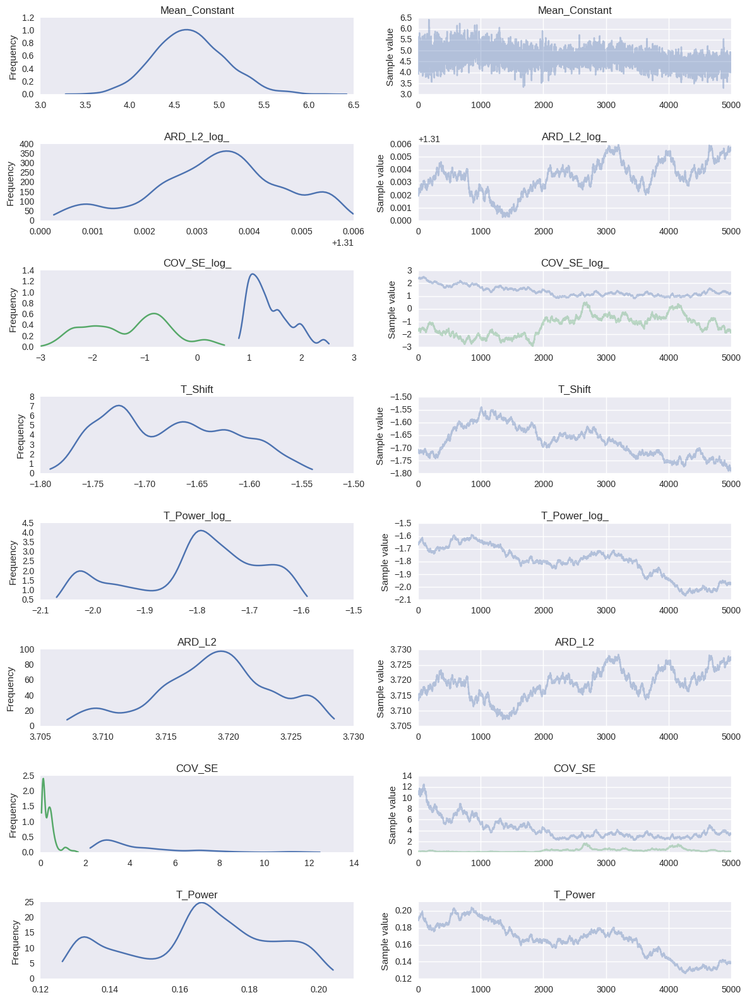

In [229]:
gp.style_seaborn()
_ = pm.traceplot(trace,plot_transformed=True)
def get_model(i):
    return {v.name:trace[i][v.name] for v in model.vars}

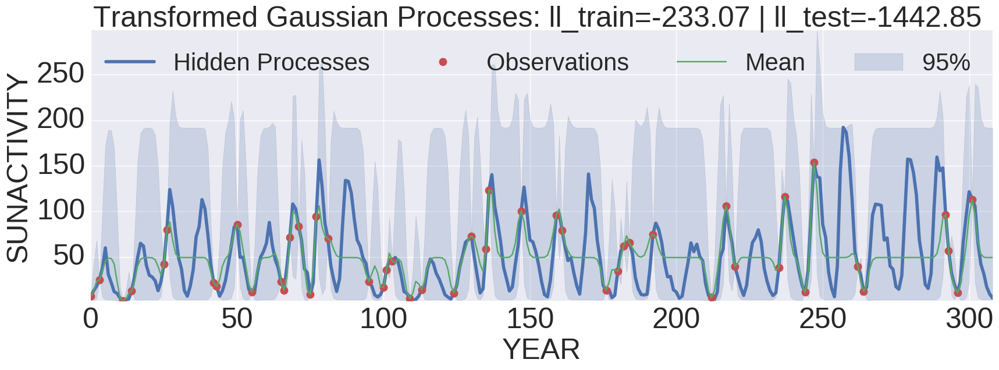

In [230]:
gp.style_big_seaborn()
plot_data()
plot_tgp(model,**start)

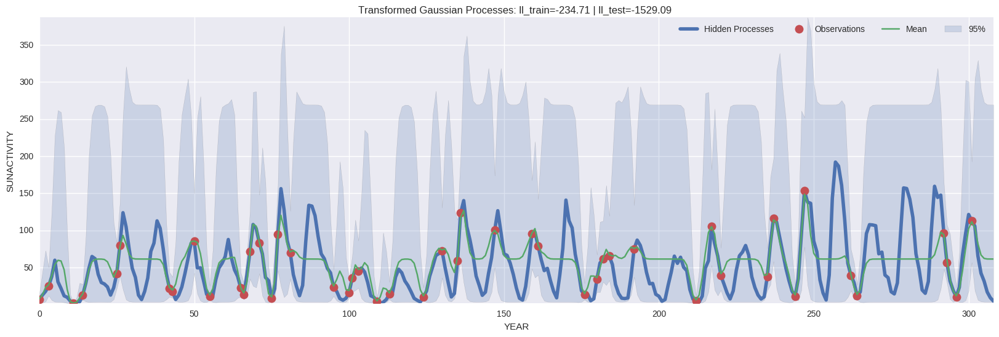

In [231]:
gp.style_big_seaborn()
@interact(idmodel=[0, len(trace)-1])
def plot_model(idmodel=0):
    plot_data()
    plot_tgp(model,**get_model(int(idmodel)))

In [232]:
datatrace = gp.trace_to_dataframe(trace,hide_transformed_vars=False)
gp.add_likelihood_to_dataframe(model,datatrace,trace)
datatrace.describe().T

,count,mean,std,min,25%,50%,75%,max
T_Power,5000.0,0.165822,0.020387,0.126317,0.149749,0.166910,0.180732,0.204064
Mean_Constant,5000.0,4.671268,0.398694,3.281257,4.398845,4.655203,4.927432,6.420544
T_Power_log_,5000.0,-1.804680,0.126441,-2.068962,-1.898798,-1.790301,-1.710742,-1.589319
T_Shift,5000.0,-1.675982,0.059662,-1.790640,-1.726454,-1.677187,-1.626024,-1.539676
ARD_L2_log_,5000.0,1.313417,0.001268,1.310256,1.312643,1.313465,1.314225,1.315989
COV_SE_log___0,5000.0,1.382626,0.383606,0.799344,1.074712,1.279435,1.623119,2.524627
COV_SE_log___1,5000.0,-1.297380,0.776580,-2.984916,-1.969856,-1.148701,-0.734812,0.523547
ARD_L2,5000.0,3.718838,0.004713,3.707124,3.715982,3.719037,3.721865,3.728437
COV_SE__0,5000.0,4.322665,1.959733,2.224082,2.929148,3.594609,5.068875,12.486234
COV_SE__1,5000.0,0.365860,0.293186,0.050544,0.139477,0.317048,0.479596,1.688005


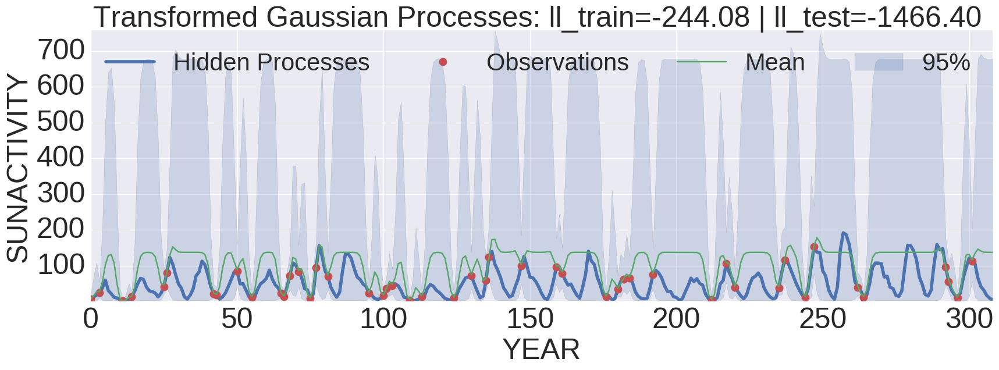

In [235]:
index_sorted = datatrace.sort_values(by='ll').index
gp.style_big_seaborn()
@interact(nmodel=[0, len(trace)-1])
def plot_model(nmodel=0):
    plot_data()
    plot_tgp(model,**get_model(int(index_sorted[nmodel])))

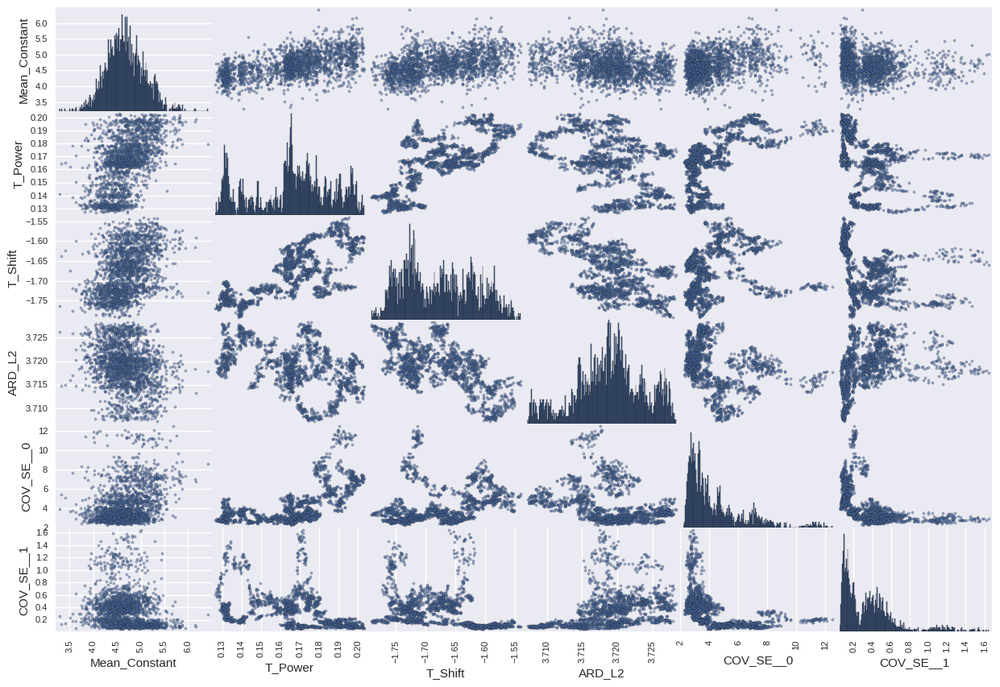

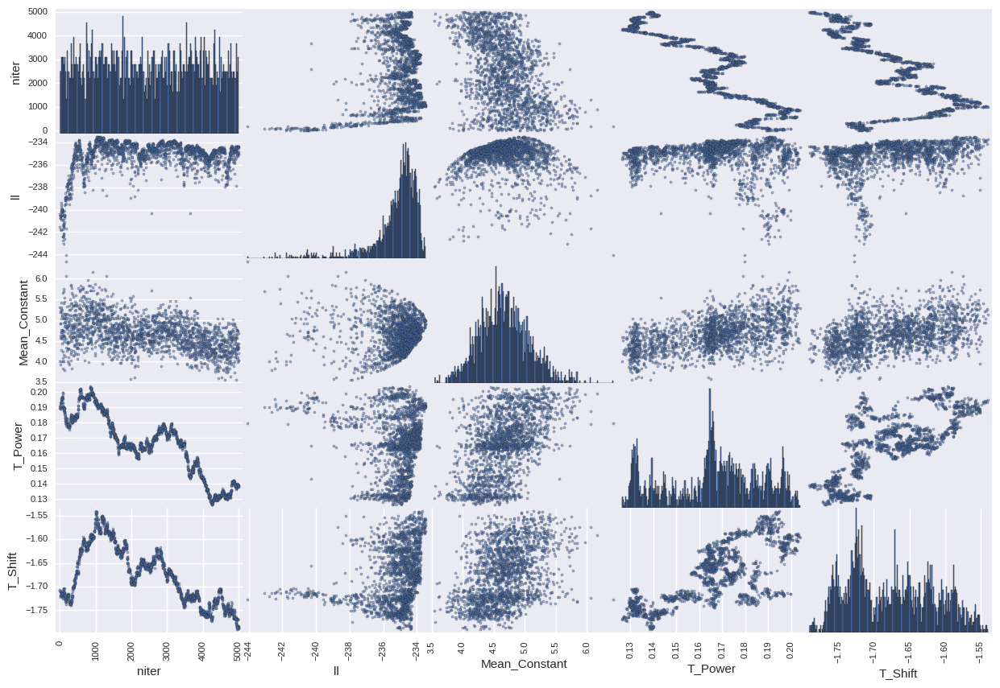

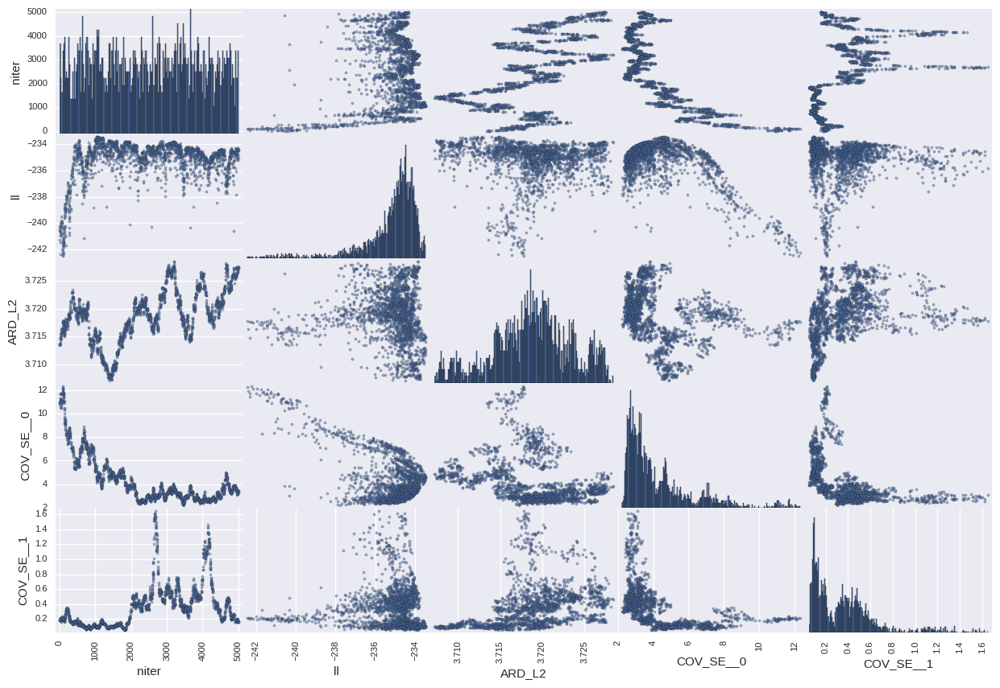

In [234]:
gp.style_seaborn()
items_ll = ['niter','ll']
items_mt = ['Mean_Constant','T_Power','T_Shift']
items_k = ['ARD_L2','COV_SE__0','COV_SE__1']

gp.scatter_trace(datatrace,items=(items_mt+items_k))
gp.scatter_trace(datatrace,items=(items_ll+items_mt))
gp.scatter_trace(datatrace,items=(items_ll+items_k))

In [ ]:
import theano.sandbox.linalg as sT
trans = tt.log(sT.det(tt.jacobian(g3.mapping.inv(value),value)))
ftrans = th.function([value]+model.point_to_In(init),trans,allow_input_downcast=True)
yyy = np.zeros_like(grilla)
i = 0
for xxx in grilla:
    yyy[i] = ftrans(np.array([xxx]))
    i+=1
plt.plot(grilla,yyy)